In [1]:
from panel_segmentation import utils
import glob
import matplotlib.pyplot as plt
from PIL import Image
import os
import pandas as pd
import folium
from mmengine import Config
from mmdet.apis import init_detector, inference_detector
from mmdet.registry import VISUALIZERS
from shapely.geometry import Polygon
import mmcv

# Only flag for single warning if there are repeats
import warnings
warnings.filterwarnings(action='once')

C:\Users\kperry\.conda\envs\deep-learning\Lib\site-packages\mmengine\optim\optimizer\zero_optimizer.py:11: DeprecationWarning: `TorchScript` support for functional optimizers is deprecated and will be removed in a future PyTorch release. Consider using the `torch.compile` optimizer instead.
  from torch.distributed.optim import \


# Run the SOL-Searcher Pipeline on an Example Area

Take a gridded set of images of a small area and visualize them.

In [2]:
# Pull an area of images in the Austin metro area to run through the SOL-Searcher model. Use the generate_satellite_imagery_grid() function to do this.
northwest_lat, northwest_lon =  30.304107, -97.708710
southeast_lat, southeast_lon =  30.299329, -97.697781
google_maps_api_key = "YOUR_API_KEY_HERE"
zoom_level = 19
file_save_folder = "./panel_segmentation/examples/sol-searcher_data_examples"
grid_info_list = utils.generateSatelliteImageryGrid(northwest_lat, northwest_lon,
                                                       southeast_lat, southeast_lon,
                                                       google_maps_api_key,
                                                       file_save_folder,
                                                       zoom_level,
                                                       lat_lon_distance=.0014)

File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!


Visualize some of the imagery in the grid as reference.

30.304107_-97.70871.png
30.302707_-97.70871.png
30.301307_-97.70871.png
30.299907_-97.70871.png
30.298507_-97.70871.png
30.304107_-97.70731.png
30.302707_-97.70731.png
30.301307_-97.70731.png
30.299907_-97.70731.png
30.298507_-97.70731.png
30.304107_-97.70591.png
30.302707_-97.70591.png
30.301307_-97.70591.png
30.299907_-97.70591.png
30.298507_-97.70591.png
30.304107_-97.70451.png
30.302707_-97.70451.png
30.301307_-97.70451.png
30.299907_-97.70451.png
30.298507_-97.70451.png
30.304107_-97.70311.png
30.302707_-97.70311.png
30.301307_-97.70311.png
30.299907_-97.70311.png
30.298507_-97.70311.png
30.304107_-97.70171.png
30.302707_-97.70171.png
30.301307_-97.70171.png
30.299907_-97.70171.png
30.298507_-97.70171.png
30.304107_-97.70031.png
30.302707_-97.70031.png
30.301307_-97.70031.png
30.299907_-97.70031.png
30.298507_-97.70031.png
30.304107_-97.69891.png
30.302707_-97.69891.png
30.301307_-97.69891.png
30.299907_-97.69891.png
30.298507_-97.69891.png
30.304107_-97.69751.png
30.302707_-97.69

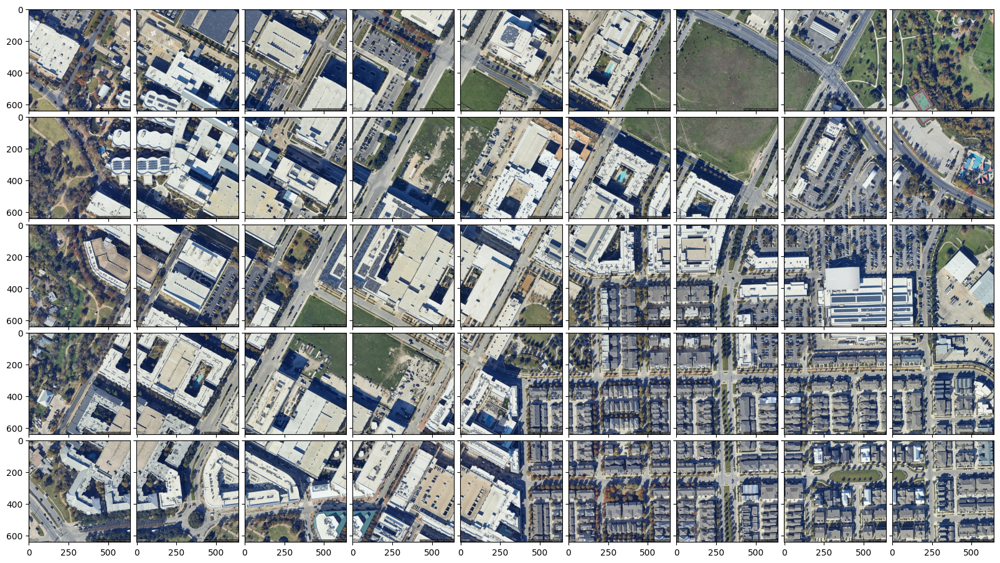

In [3]:
plot = utils.visualizeSatelliteImageryGrid(grid_info_list, file_save_folder)
plt.show()

Let's load in the SOL-searcher algorithm, run some imagery through it, and visualize the outputs.

Loads checkpoint by local backend from path: ./panel_segmentation/models/hail_model.pth


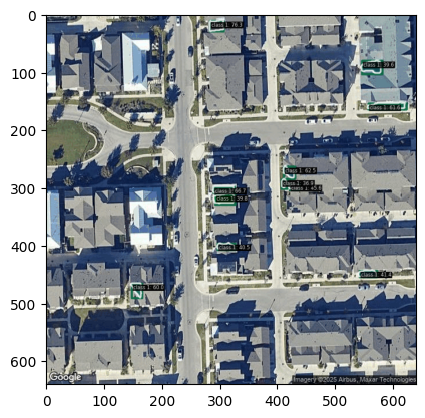

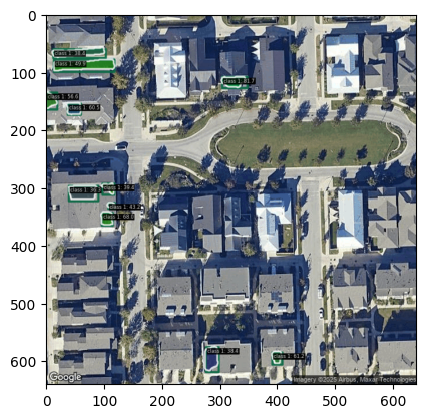

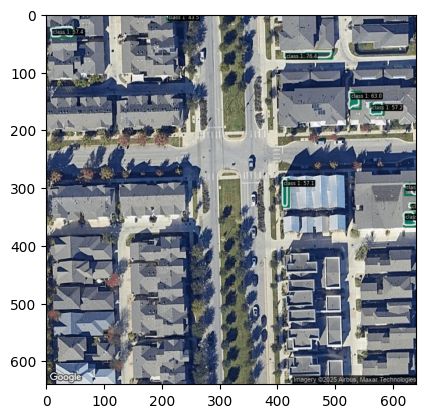

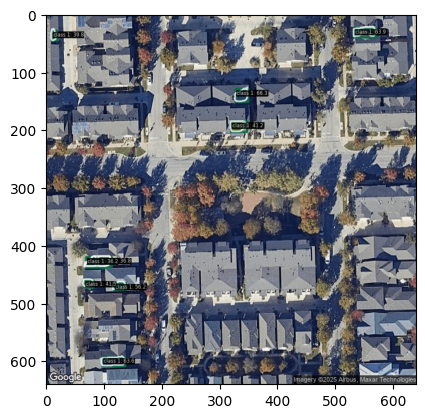

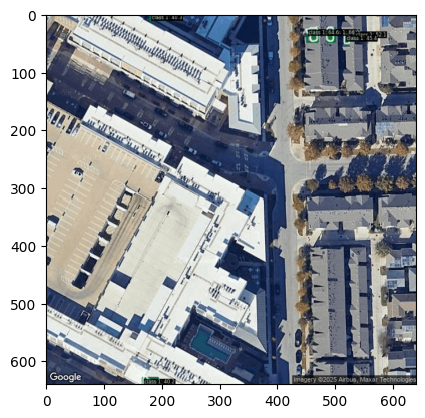

...

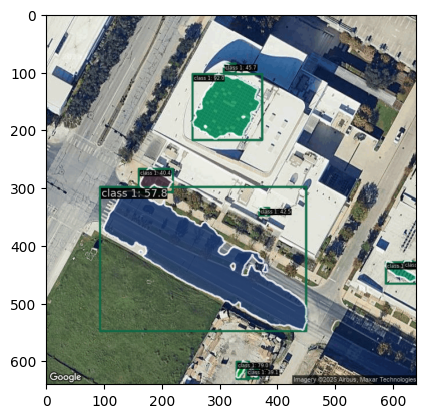

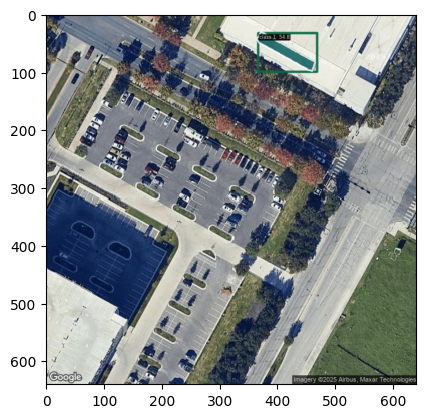

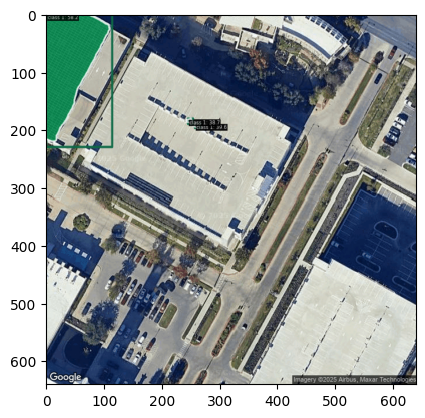

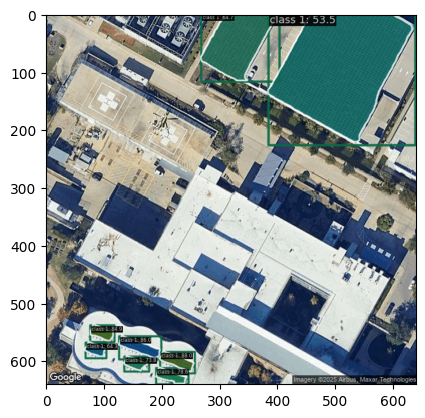

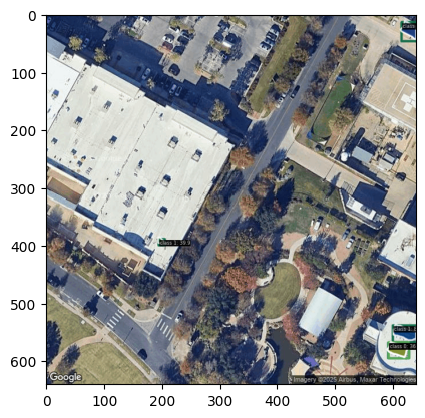

In [25]:
cfg = Config.fromfile("./panel_segmentation/models/hail_config.py")
checkpoint_file = "./panel_segmentation/models/hail_model.pth"
model = init_detector(cfg, checkpoint_file, device='cpu')
visualizer = VISUALIZERS.build(model.cfg.visualizer)

grid_files = glob.glob(os.path.join(file_save_folder, "*.png"))
# Run inference on the example images
inference_data_list = list()
results = list()
for file in grid_files:
    img = mmcv.imread(file, channel_order='rgb')
    new_result = inference_detector(model, img)
    visualizer.add_datasample(
          file,
          img,
          data_sample=new_result,
          draw_gt=None,
          wait_time=0,
          pred_score_thr=0.35
          )
    img = visualizer.get_image()
    plt.imshow(img)
    plt.show()
    plt.close()
    new_result.file = file
    results.append(new_result)

Let's visualize some of the result outputs from the model.

In [27]:
# Loop through each inference result and get the lat-lon coordinates of the centroid of the box outputs
solar_location_list = list()
for result in results:
    file_name = os.path.basename(result.file)
    print(file_name)
    img_center_lat, img_center_lon = float(file_name.split("_")[0]), float(file_name.split("_")[-1].replace(".png", ""))
    image_x_pixels, image_y_pixels = result.img_shape
    boxes = result.pred_instances.bboxes
    for box in boxes:
        np_box = list(box.numpy())
        box_lat, box_lon = utils.getInferenceBoxLatLonCoordinates(np_box, img_center_lat, img_center_lon,
                                                                  image_x_pixels, image_y_pixels,
                                                                  zoom_level)
        solar_location_list.append((box_lat, box_lon))

30.298507_-97.69751.png
30.298507_-97.69891.png
30.298507_-97.70031.png
30.298507_-97.70171.png
30.298507_-97.70311.png
30.298507_-97.70451.png
30.298507_-97.70591.png
30.298507_-97.70731.png
30.298507_-97.70871.png
30.299907_-97.69751.png
30.299907_-97.69891.png
30.299907_-97.70031.png
30.299907_-97.70171.png
30.299907_-97.70311.png
30.299907_-97.70451.png
30.299907_-97.70591.png
30.299907_-97.70731.png
30.299907_-97.70871.png
30.301307_-97.69751.png
30.301307_-97.69891.png
30.301307_-97.70031.png
30.301307_-97.70171.png
30.301307_-97.70311.png
30.301307_-97.70451.png
30.301307_-97.70591.png
30.301307_-97.70731.png
30.301307_-97.70871.png
30.302707_-97.69751.png
30.302707_-97.69891.png
30.302707_-97.70031.png
30.302707_-97.70171.png
30.302707_-97.70311.png
30.302707_-97.70451.png
30.302707_-97.70591.png
30.302707_-97.70731.png
30.302707_-97.70871.png
30.304107_-97.69751.png
30.304107_-97.69891.png
30.304107_-97.70031.png
30.304107_-97.70171.png
30.304107_-97.70311.png
30.304107_-97.70

If we want to associate individual installations to specific buildings, we can use Google's geocoding API to get individual addresses for each PV installation.

In [28]:
solar_install_address_list = list()
for lat_lon_coords in solar_location_list:
    latitude, longitude = lat_lon_coords[0], lat_lon_coords[1]
    # Look up the address associated with lat-lon coordinate
    solar_install_address = utils.generateAddress(latitude, longitude, google_maps_api_key)
    solar_install_address_list.append({"latitude": latitude,
                                       "longitude": longitude,
                                       "address": solar_install_address})

C:\Users\kperry\.conda\envs\deep-learning\Lib\site-packages\urllib3\connectionpool.py:1097: InsecureRequestWarning: Unverified HTTPS request is being made to host 'maps.googleapis.com'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-warnings
  warnings.warn(


IndexError: list index out of range

 We can then take the median lat-lon coordinates by address as our main address-level lat-lon coordinates, and visualize the resulting dataframe.

In [8]:
solar_address_df = pd.DataFrame(solar_install_address_list)
solar_address_df['median_latitude_address'] = solar_address_df.groupby("address")['latitude'].transform('median')
solar_address_df['median_longitude_address'] = solar_address_df.groupby("address")['longitude'].transform('median')
# Sort by address
solar_address_df = solar_address_df.sort_values(by='address')
solar_address_df.head(10)

,latitude,longitude,address,median_latitude_address,median_longitude_address
201,30.304712,-97.707278,"1301 Barbara Jordan Blvd #200G, Austin, TX 787...",30.304712,-97.707278
205,30.304519,-97.706804,"1301 Barbara Jordan Blvd #200g, Austin, TX 787...",30.304619,-97.706646
195,30.304641,-97.706597,"1301 Barbara Jordan Blvd #200g, Austin, TX 787...",30.304619,-97.706646
196,30.304597,-97.706611,"1301 Barbara Jordan Blvd #200g, Austin, TX 787...",30.304619,-97.706646
204,30.304675,-97.706681,"1301 Barbara Jordan Blvd #200g, Austin, TX 787...",30.304619,-97.706646
192,30.304468,-97.703134,"1500 Barbara Jordan Blvd, Austin, TX 78723, USA",30.304468,-97.703134
135,30.300691,-97.698279,"1801 E 51st St H.E.B, Austin, TX 78723, USA",30.300681,-97.698710
132,30.300962,-97.698787,"1801 E 51st St H.E.B, Austin, TX 78723, USA",30.300681,-97.698710
138,30.300670,-97.698724,"1801 E 51st St H.E.B, Austin, TX 78723, USA",30.300681,-97.698710
140,30.300670,-97.698284,"1801 E 51st St H.E.B, Austin, TX 78723, USA",30.300681,-97.698710


Using aggregated address data, map the addresses containing solar installations in Folium. Please note, this map may include older satellite imagery and there may be discrepancies if solar installs are present in newer scans from Google Maps (i.e. solar was recently installed). Outputs of this algorithm should be manually reviewed to determine if there any discrepancies.

In [11]:
solar_address_df_agg = solar_address_df[['address',
                                         'median_latitude_address',
                                         'median_longitude_address']].drop_duplicates()

# Create folium map to visualize the solar addresses
folium_map = folium.Map(location=[solar_address_df_agg['median_latitude_address'].mean(),
                                  solar_address_df_agg['median_longitude_address'].mean()],
                        tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                        attr = 'Esri',
                        name = 'Esri Satellite',
                        zoom_start=14,
                        max_zoom=19)
solar_feature_group = folium.FeatureGroup(name="solar", show=True)
for idx, row in solar_address_df_agg.iterrows():
    lat = row['median_latitude_address']
    lon = row['median_longitude_address']
    folium.CircleMarker([lat, lon],
                        color='b',
                        weight=.05,
                        fill=True,
                        fill_opacity=0.6,
                        fill_color='red',
                        radius=3).add_to(solar_feature_group)

folium_map.add_child(solar_feature_group)
folium_map